In [ ]:
!gdown --folder --id 1B19RWODijlUlXEdvLKxjcmlg-BiJcbWE -O /content/shared_folder

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Retrieving folder contents
Processing file 1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7 coco2017_subset.zip
Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From (original): https://drive.google.com/uc?id=1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7
From (redirected): https://drive.google.com/uc?id=1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7&confirm=t&uuid=27b71dc8-2578-440a-8f85-126e9cb6b13a
To: /content/shared_folder/coco2017_subset.zip
100% 6.71G/6.71G [01:29<00:00, 75.3MB/s]
Download completed


In [ ]:
import os
os.listdir("/content/shared_folder")

['coco2017_subset.zip']

In [ ]:
!unzip /content/shared_folder/coco2017_subset.zip -d /content/extracted_files

Streaming output truncated to the last 5000 lines.
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508801.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508836.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508855.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508861.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508878.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508881.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508906.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508938.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508969.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508972.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508984.jpg  
  inflating: /content/extracted_file

In [ ]:
import os
import random
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2

In [ ]:
# Path to your COCO annotation file (change this to your subset JSON file)
ANNOTATION_FILE = '/content/extracted_files/coco2017_subset/annotation_subset/instances_train2017_subset.json'
# Folder where the corresponding images are stored
IMAGE_FOLDER = '/content/extracted_files/coco2017_subset/train2017'

In [ ]:
# Initialize COCO API for instance annotations
coco = COCO(ANNOTATION_FILE)

loading annotations into memory...
Done (t=4.79s)
creating index...
index created!


In [ ]:
img_ids = coco.getImgIds()
ann_ids = coco.getAnnIds()
cat_ids = coco.getCatIds()

# Load category information
categories = coco.loadCats(cat_ids)
category_names = [cat['name'] for cat in categories]

# Print basic dataset information
print("----- COCO Dataset Basic Information -----")
print(f"Total number of images: {len(img_ids)}")
print(f"Total number of annotations: {len(ann_ids)}")
print(f"Total number of categories: {len(cat_ids)}")

----- COCO Dataset Basic Information -----
Total number of images: 29571
Total number of annotations: 212806
Total number of categories: 80


loading annotations into memory...
Done (t=0.16s)
creating index...
index created!
Number of images in the validation dataset: 1250


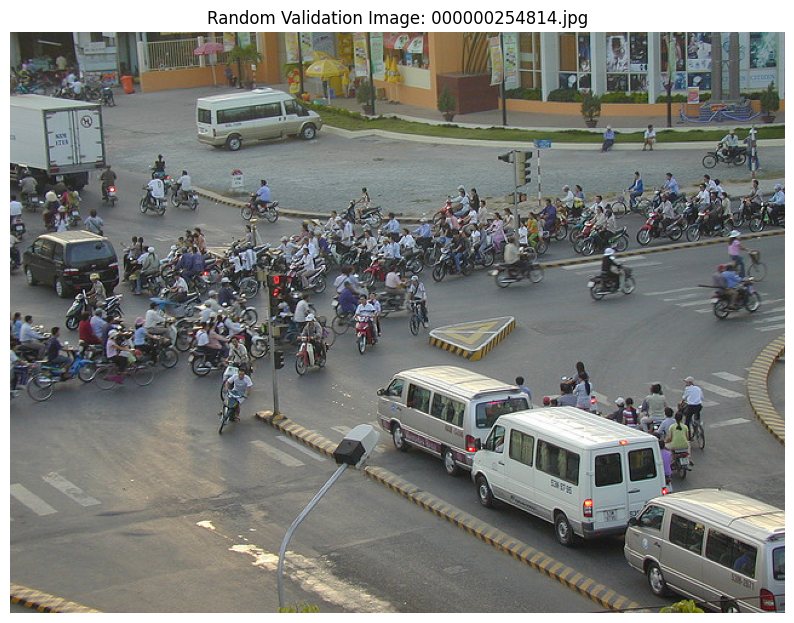

In [ ]:
VAL_ANNOTATION_FILE = '/content/extracted_files/coco2017_subset/annotation_subset/instances_val2017_subset.json'
VAL_IMAGE_FOLDER = '/content/extracted_files/coco2017_subset/val2017'

# Initialize COCO API for validation annotations
coco_val = COCO(VAL_ANNOTATION_FILE)

# Retrieve all image IDs in the validation dataset
val_img_ids = coco_val.getImgIds()

# Print the number of images in the validation dataset
print("Number of images in the validation dataset:", len(val_img_ids))

# Select one random image ID from the validation dataset
rand_img_id = random.choice(val_img_ids)
img_data = coco_val.loadImgs(rand_img_id)[0]

# Construct the full image path
image_path = os.path.join(VAL_IMAGE_FOLDER, img_data['file_name'])

# Load the image using OpenCV
image = cv2.imread(image_path)
if image is None:
    print(f"Could not load image at {image_path}")
else:
    # Convert image from BGR (OpenCV's default) to RGB for displaying with matplotlib
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image using matplotlib
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.title(f"Random Validation Image: {img_data['file_name']}")
    plt.axis('off')
    plt.show()

In [ ]:
print("Categories:", category_names)

Categories: ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


----- Category Analysis -----
person: 65165 annotations
bicycle: 1731 annotations
car: 10945 annotations
motorcycle: 2105 annotations
airplane: 1369 annotations
bus: 1449 annotations
train: 1136 annotations
truck: 2649 annotations
boat: 2815 annotations
traffic light: 2982 annotations
fire hydrant: 480 annotations
stop sign: 522 annotations
parking meter: 291 annotations
bench: 2398 annotations
bird: 2839 annotations
cat: 1227 annotations
dog: 1409 annotations
horse: 1677 annotations
sheep: 2168 annotations
cow: 1855 annotations
elephant: 1348 annotations
bear: 321 annotations
zebra: 1283 annotations
giraffe: 1311 annotations
backpack: 2243 annotations
umbrella: 2708 annotations
handbag: 3019 annotations
tie: 1618 annotations
suitcase: 1465 annotations
frisbee: 724 annotations
skis: 1701 annotations
snowboard: 709 annotations
sports ball: 1590 annotations
kite: 2239 annotations
baseball bat: 802 annotations
baseball glove: 893 annotations
skateboard: 1399 annotations
surfboard: 1507 an

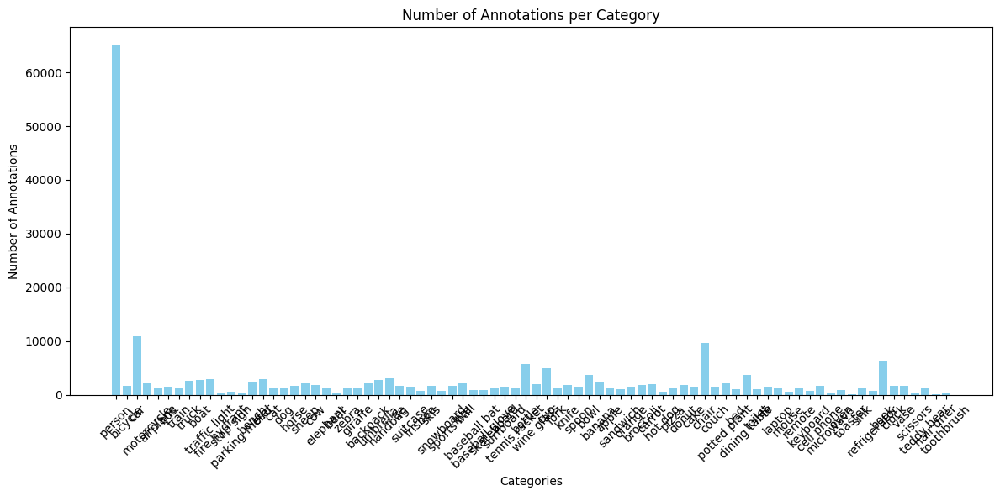

In [ ]:
 category_counts = {}

for cat in categories:
    # For each category, get the number of annotations
    ann_ids = coco.getAnnIds(catIds=cat['id'])
    count = len(ann_ids)
    category_counts[cat['name']] = count

# Print out the analysis information
print("----- Category Analysis -----")
for cat_name, count in category_counts.items():
    print(f"{cat_name}: {count} annotations")

# Plot the category distribution as a bar chart
plt.figure(figsize=(12, 6))
plt.bar(category_counts.keys(), category_counts.values(), color='skyblue')
plt.xlabel("Categories")
plt.ylabel("Number of Annotations")
plt.title("Number of Annotations per Category")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

----- Annotations per Image Distribution -----
Total Images: 29571
Mean Annotations per Image: 7.20
Median Annotations per Image: 4.0
Min Annotations per Image: 0
Max Annotations per Image: 78


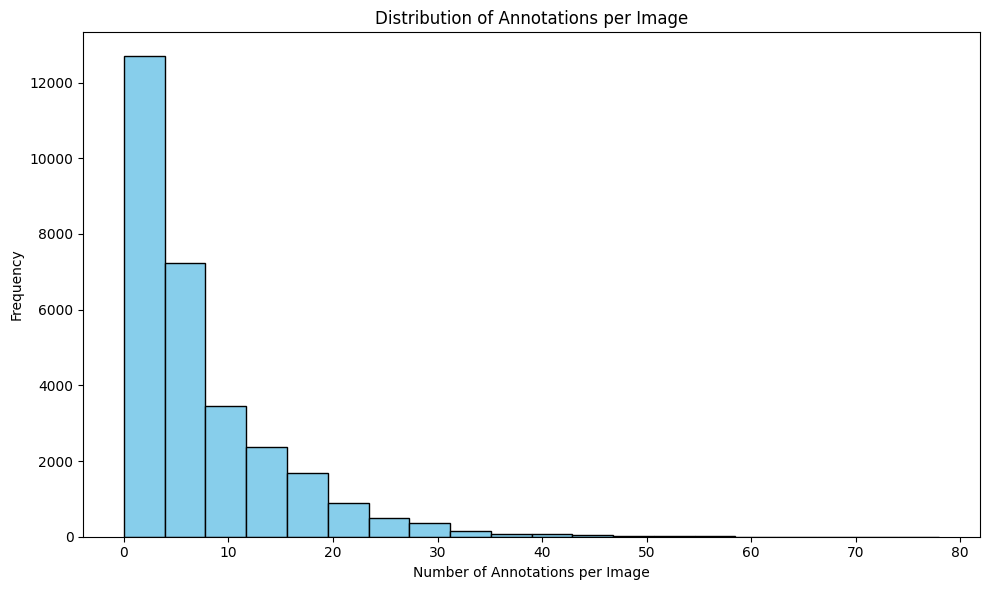

In [ ]:
import numpy as np

img_ids = coco.getImgIds()

# Create a list to store the number of annotations for each image
annotations_per_image = []

# Loop through each image and count the annotations
for img_id in img_ids:
    ann_ids = coco.getAnnIds(imgIds=img_id)
    annotations_per_image.append(len(ann_ids))

# Print basic statistics
print("----- Annotations per Image Distribution -----")
print(f"Total Images: {len(img_ids)}")
print(f"Mean Annotations per Image: {np.mean(annotations_per_image):.2f}")
print(f"Median Annotations per Image: {np.median(annotations_per_image)}")
print(f"Min Annotations per Image: {np.min(annotations_per_image)}")
print(f"Max Annotations per Image: {np.max(annotations_per_image)}")

# Plot the distribution as a histogram
plt.figure(figsize=(10, 6))
plt.hist(annotations_per_image, bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Number of Annotations per Image')
plt.ylabel('Frequency')
plt.title('Distribution of Annotations per Image')
plt.tight_layout()
plt.show()

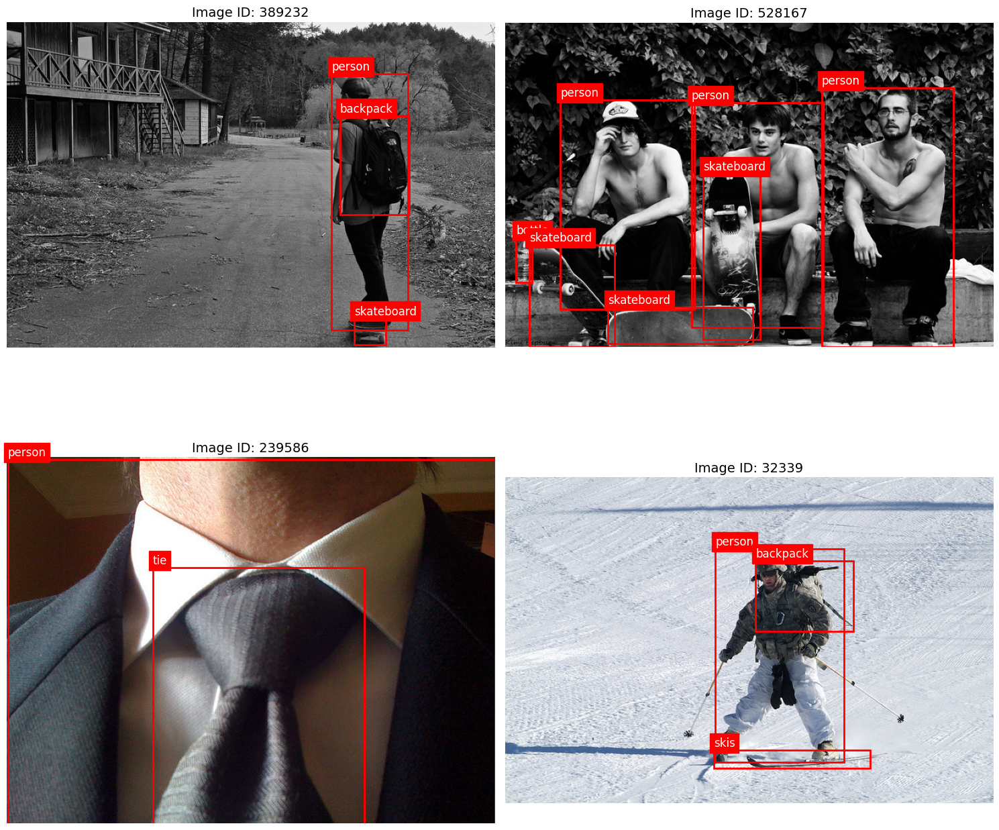

In [ ]:
img_ids = coco.getImgIds()
num_samples = 4
sample_img_ids = random.sample(img_ids, num_samples)

# Set up the plot grid
fig, axs = plt.subplots(2, 2, figsize=(15, 15))
axs = axs.flatten()

# Loop through each sample image
for i, img_id in enumerate(sample_img_ids):
    # Load image metadata
    img_data = coco.loadImgs(img_id)[0]
    image_path = os.path.join(IMAGE_FOLDER, img_data['file_name'])

    # Read the image using OpenCV and convert from BGR to RGB
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Unable to load image at {image_path}")
        continue
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get annotations for this image
    ann_ids = coco.getAnnIds(imgIds=img_id)
    anns = coco.loadAnns(ann_ids)

    # Display the image
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(f"Image ID: {img_id}", fontsize=14)

    # Add bounding boxes and labels to the image
    for ann in anns:
        # COCO bounding box format: [x, y, width, height]
        bbox = ann['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                                 linewidth=2, edgecolor='red', facecolor='none')
        axs[i].add_patch(rect)

        # Get the category name for the annotation
        cat = coco.loadCats(ann['category_id'])[0]
        cat_name = cat['name']

        # Display the category name above the bounding box
        axs[i].text(bbox[0], bbox[1] - 5, cat_name,
                    color='white', fontsize=12, backgroundcolor='red')

plt.tight_layout()
plt.show()

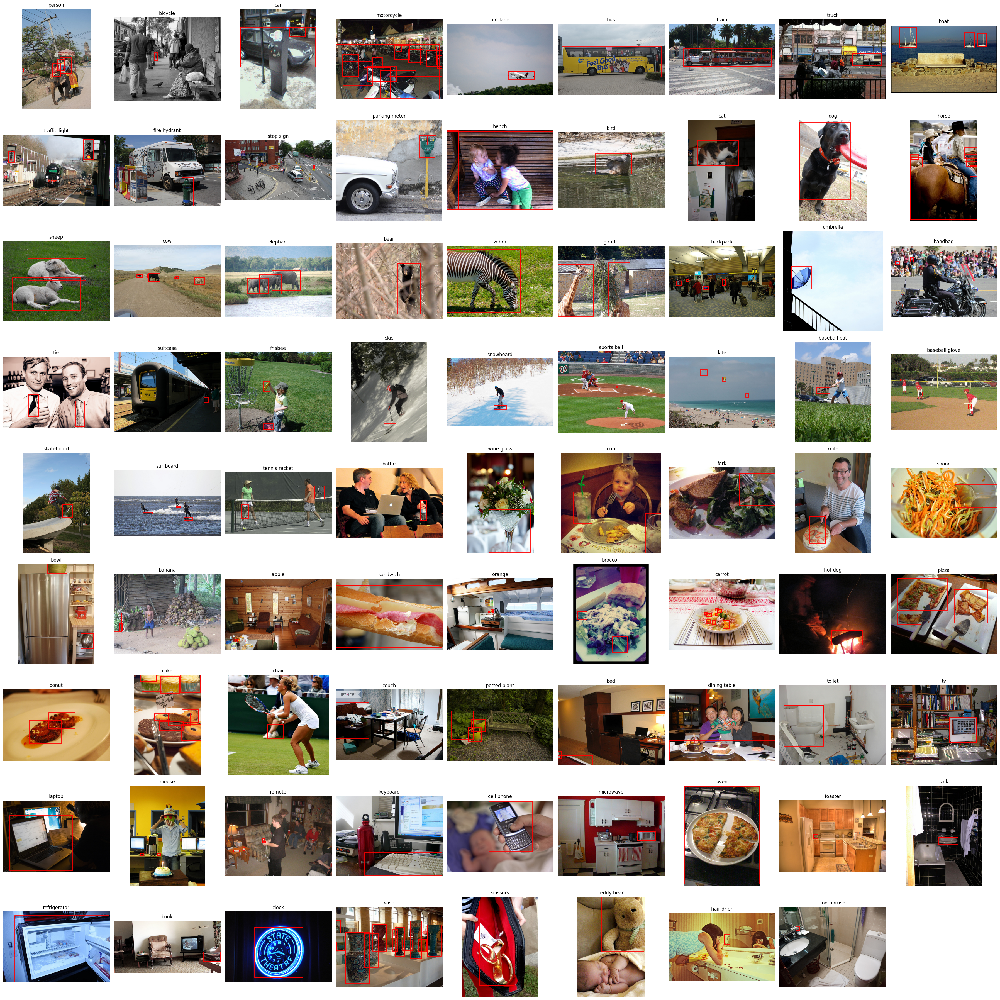

In [ ]:
import math

n_categories = len(categories)

# Determine grid size for plotting (adjust grid size based on number of categories)
cols = int(math.sqrt(n_categories))
if cols * cols < n_categories:
    cols += 1
rows = math.ceil(n_categories / cols)

plt.figure(figsize=(cols * 4, rows * 4))

# Loop through each category
for i, cat in enumerate(categories):
    cat_id = cat['id']
    # Get image IDs that contain the current category
    img_ids = coco.getImgIds(catIds=[cat_id])
    if not img_ids:
        continue  # Skip if no images are found for this category

    # Select one random image that contains the category
    img_id = random.choice(img_ids)
    img_data = coco.loadImgs(img_id)[0]
    image_path = os.path.join(IMAGE_FOLDER, img_data['file_name'])

    # Load the image using OpenCV
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Could not load image {image_path}")
        continue
    # Convert the image from BGR (OpenCV format) to RGB (for matplotlib)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get annotations for the selected image, but only for the current category
    ann_ids = coco.getAnnIds(imgIds=img_id, catIds=[cat_id])
    anns = coco.loadAnns(ann_ids)

    # Create subplot for the current category
    ax = plt.subplot(rows, cols, i + 1)
    ax.imshow(image)
    ax.set_title(cat['name'])
    ax.axis('off')

    # Draw bounding boxes for each annotation corresponding to the category
    for ann in anns:
        bbox = ann['bbox']  # Format: [x, y, width, height]
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                                 linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

plt.tight_layout()
plt.show()